# Intro

## 1.1. The Blocker Fraud Company

**Blocker Fraud Company** is a specialized company in fraud detection on financial transactions through mobile devices. It has the "Blocker Fraud" service, wich guarantee the block of fraudulent transactions.

The company business model is service type, with monetization made by performance of the provided service. The user pay a fixed fee on the fraud detection success.

## 1.2. Expansion Strategy in Brazil

Aiming to expand business in Brazil it has adopted the following strategy:

* The company will receive 25% of the value of each transaction detected as *fraud*.
* The company will receive 5% of the value of each transaction detected as *fraud*, but the transaction is *legitimate*.
* The company will return 100% of the value to the customer, for each transaction detected as legitimate, however a transaction is a fraud.

## 1.3. Context
There is a lack of public available datasets on financial services and specially in the emerging mobile money transactions domain. Financial datasets are important to many researchers and in particular to us performing research in the domain of fraud detection. Part of the problem is the intrinsically private nature of financial transactions, that leads to no publicly available datasets.

We present a synthetic dataset generated using the simulator called PaySim as an approach to such a problem. PaySim uses aggregated data from the private dataset to generate a synthetic dataset that resembles the normal operation of transactions and injects malicious behaviour to later evaluate the performance of fraud detection methods.

## 1.4. Content
PaySim simulates mobile money transactions based on a sample of real transactions extracted from one month of financial logs from a mobile money service implemented in an African country. The original logs were provided by a multinational company, who is the provider of the mobile financial service which is currently running in more than 14 countries all around the world.

This synthetic dataset is scaled down 1/4 of the original dataset and it is created just for Kaggle.

## 1.5. Goal
1. What is the model's *precision* and *accuracy*?
2. How reliable is the model in classifying transactions as *legitimate* or *fraudulent*?
3. What is the expected billing by the company if we classify 100% of data transactions with the model?
4. What is the loss expected by company in case of model failure ?
5. What is the profit expected by the **Blocker Fraud Company** when using model?

`Disclaimer: The following context is completely fictional, the company, the context, the CEO and the business questions.`

## 1.6. Data

Data provided by Kaggle: [Synthetic Financial Datasets for Fraud Detection](https://www.kaggle.com/ntnu-testimon/paysim1)

## 1.7. Analysis

This solution will use descriptive statistics and data visualization to find key figures in understanding the distribution, count, and relationship between variables. Since the goal of the project to make predictions on the fraud's detection, classification algorithms from the supervised learning family of machine learning models will be implemented.

## 1.8. Evaluation

The project will conclude with the evaluation of the machine learning model selected with a validation data set. The output of the predictions can be checked through a confusion matrix, and metrics such as accuracy, precision, recall, F1 and Kappa scores.

# 2. Data

## Loading Data

In [1]:
# importing
import numpy as np
import pandas as pd

# data viz
import matplotlib.pyplot as plt
import seaborn as sns

# machine learning models
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

# preprocessing
from sklearn.preprocessing import MinMaxScaler

# metrics
from sklearn.metrics import classification_report, accuracy_score, precision_score, recall_score, f1_score, confusion_matrix

# model selection
from sklearn.model_selection import train_test_split, cross_val_score

# read csv
df = pd.read_csv('PS_20174392719_1491204439457_log.csv')

## Data Check

In [2]:
# rows and columns
print(df.shape)

# check first five rows
df.head()

(6362620, 11)


,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
0,1,PAYMENT,9839.64,C1231006815,170136.0,160296.36,M1979787155,0.0,0.0,0,0
1,1,PAYMENT,1864.28,C1666544295,21249.0,19384.72,M2044282225,0.0,0.0,0,0
2,1,TRANSFER,181.00,C1305486145,181.0,0.00,C553264065,0.0,0.0,1,0
3,1,CASH_OUT,181.00,C840083671,181.0,0.00,C38997010,21182.0,0.0,1,0
4,1,PAYMENT,11668.14,C2048537720,41554.0,29885.86,M1230701703,0.0,0.0,0,0


In [3]:
df.dtypes

step                int64
type               object
amount            float64
nameOrig           object
oldbalanceOrg     float64
newbalanceOrig    float64
nameDest           object
oldbalanceDest    float64
newbalanceDest    float64
isFraud             int64
isFlaggedFraud      int64
dtype: object

## About Data

### Headers

| Feature        | Description                                                  |
| :------------- | :----------------------------------------------------------- |
| step           | maps a unit of time in the real world. In this case 1 step is 1 hour of time. Total steps 744 (30 days simulation). |
| type           | Transaction type (CASH-IN, CASH-OUT, DEBIT, PAYMENT and TRANSFER) |
| amount         | amount of the transaction in local currency                  |
| nameOrig       | customer who started the transaction                         |
| oldbalanceOrg  | initial balance before the transaction                       |
| newbalanceOrig | new balance after the transaction                            |
| nameDest       | customer who is the recipient of the transaction             |
| oldbalanceDest | initial balance recipient before the transaction. Note that there is not information for customers that start with M (Merchants) |
| newbalanceDest | new balance recipient after the transaction. Note that there is not information for customers that start with M (Merchants) |
| isFraud        | This is the transactions made by the fraudulent agents inside the simulation. In this specific dataset the fraudulent behavior of the agents aims to profit by taking control or customers accounts and try to empty the funds by transferring to another account and then cashing out of the system |
| isFlaggedFraud | The business model aims to control massive transfers from one account to another and flags illegal attempts. An illegal attempt in this dataset is an attempt to transfer more than 200K in a single transaction |

# Exploratory Data Analysis

##  Summary Statistics

In [4]:
# describe data 
df.describe()

,step,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
count,6.362620e+06,6.362620e+06,6.362620e+06,6.362620e+06,6.362620e+06,6.362620e+06,6.362620e+06,6.362620e+06
mean,2.433972e+02,1.798619e+05,8.338831e+05,8.551137e+05,1.100702e+06,1.224996e+06,1.290820e-03,2.514687e-06
std,1.423320e+02,6.038582e+05,2.888243e+06,2.924049e+06,3.399180e+06,3.674129e+06,3.590480e-02,1.585775e-03
min,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,1.560000e+02,1.338957e+04,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,2.390000e+02,7.487194e+04,1.420800e+04,0.000000e+00,1.327057e+05,2.146614e+05,0.000000e+00,0.000000e+00
75%,3.350000e+02,2.087215e+05,1.073152e+05,1.442584e+05,9.430367e+05,1.111909e+06,0.000000e+00,0.000000e+00
max,7.430000e+02,9.244552e+07,5.958504e+07,4.958504e+07,3.560159e+08,3.561793e+08,1.000000e+00,1.000000e+00


## Missing Data

It is important to check if there any missing values that might need to be imputed or removed. Luckily the data is pretty clean so no need to worry about that.

In [5]:
df.isnull().sum()

step              0
type              0
amount            0
nameOrig          0
oldbalanceOrg     0
newbalanceOrig    0
nameDest          0
oldbalanceDest    0
newbalanceDest    0
isFraud           0
isFlaggedFraud    0
dtype: int64

## Explore the Data

To verify fraudulent actions a dataset with fraud detection will be created.

# Hypothesis

## 4.1. Transactions amount
1. Fraud occour with high transactions amount.

## 4.2. Transactions Origin
1. Fraud not occour when `oldbalanceOrg` is equal to zero.
2. Fraud not occour when `newbalanceOrig` is equal to zero.

## 4.3. Transactions Destiny
1. Fraud occour when `oldbalanceDest` is equal to zero.
2. Fraud occour when `newbalanceOrig` is equal to zero.

## 4.4. Transactions Type
1. Fraud occour with cash out.
2. Fraud occour with transfer.

## List of Hypotesis

|**List of hypothesis**                                          |
| ----------------------------------------------------------- |
| H.1. Fraud occour with high transactions amount.     |
| H.2. Fraud not occour when oldbalanceOrg is equal to zero.  |
| H.3. Fraud not occour when newbalanceOrig is equal to zero. |
| H.4. Fraud occour when oldbalanceDest is equal to zero.     |
| H.5. Fraud occour when newbalanceOrig is equal to zero.     |
| H.6. Fraud occour with cash out.                            |

# Data Visualization

## 5.1. Relationship

Understand relationships between variables.

Fraudulents transactions represents 0.13% of the DataSet.

0    99.870918
1     0.129082
Name: isFraud, dtype: float64


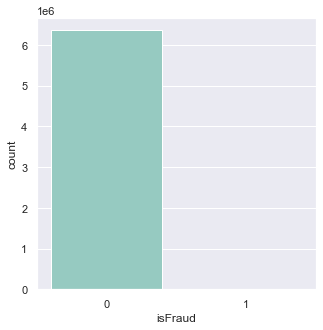

In [6]:
plt.figure(figsize=(5,5))
total2 = float(len(df))
sns.set(style="darkgrid")
print((df.isFraud.value_counts()/df.isFraud.count()) * 100)
ax = sns.countplot(data=df, x='isFraud', palette='Set3')
plt.show()

Fraud occours only in 2 type of transactions: **TRANSFER** and **CASH_OUT**.

CASH_OUT    4116
TRANSFER    4097
Name: type, dtype: int64


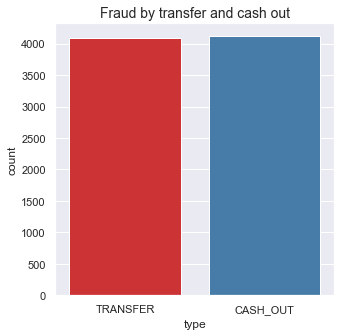

In [7]:
# fraud dataset
fraud = df[df.isFraud == 1]

# plotting most common fraud type
total = float(len(fraud))
plt.figure(figsize=(5,5))
sns.set(style="darkgrid")
print(fraud.type.value_counts())
ax = sns.countplot(data=fraud, x='type', palette='Set1')
plt.title('Fraud by transfer and cash out', fontsize=14)
plt.show()

CASH_OUT    2233384
PAYMENT     2151495
CASH_IN     1399284
TRANSFER     528812
DEBIT         41432
Name: type, dtype: int64


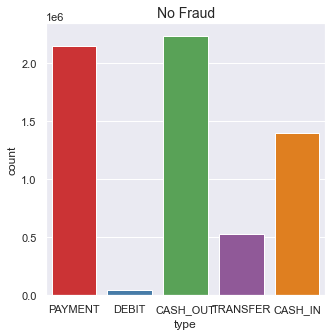

In [8]:
# no fraud dataset
no_fraud = df[df.isFraud == 0]

# plotting no fraud transactions
total = float(len(fraud))
plt.figure(figsize=(5,5))
sns.set(style="darkgrid")
print(no_fraud.type.value_counts())
ax = sns.countplot(data=no_fraud, x='type', palette='Set1')
plt.title('No Fraud', fontsize=14)
plt.show()

Fraudulent transactions represent a 1% loss.

isFraud
0    98.946479
1     1.053521
Name: amount, dtype: float64


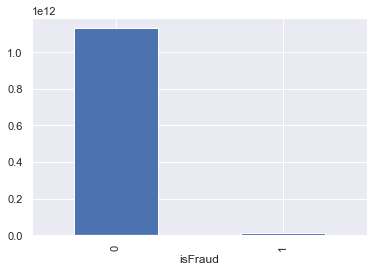

In [9]:
amount_transaction = df.groupby('isFraud')['amount'].sum()
print((amount_transaction/amount_transaction.sum())*100)
amount_transaction.plot(kind='bar')
plt.show()

There is a strong correlation between the columns: `oldbalanceOrg`, `newbalanceOrig`, `oldbalanceDest` and `newbalanceDest`.

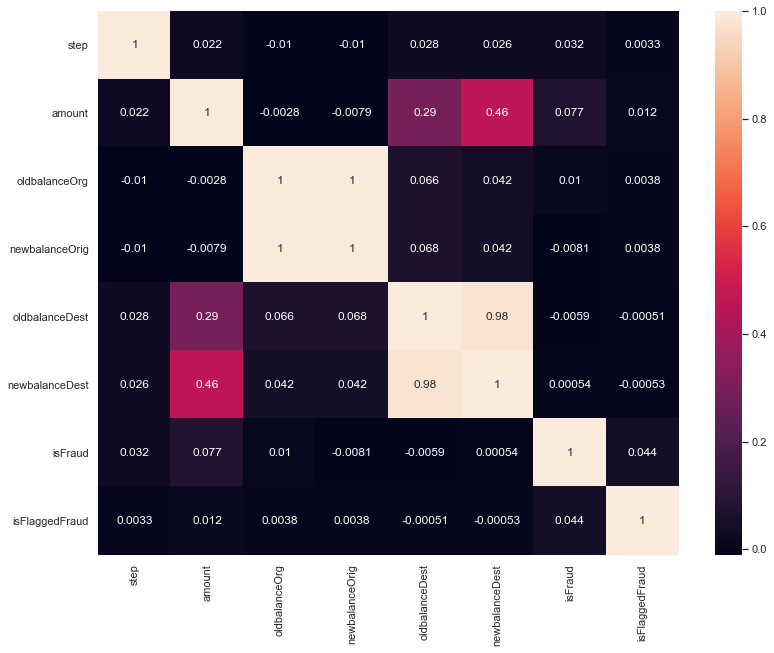

In [10]:
plt.figure(figsize=(13,10))
sns.heatmap(df.corr(), annot=True)
plt.show()

## Distribution

Show the possible values that we can expect to see in a variable, along with how likely they are.

* The step is right-skewed with less median than mean. 
* The `fraud` data has no obvious clustering, it is a *Uniform Distribution* and *symmetric skew*.

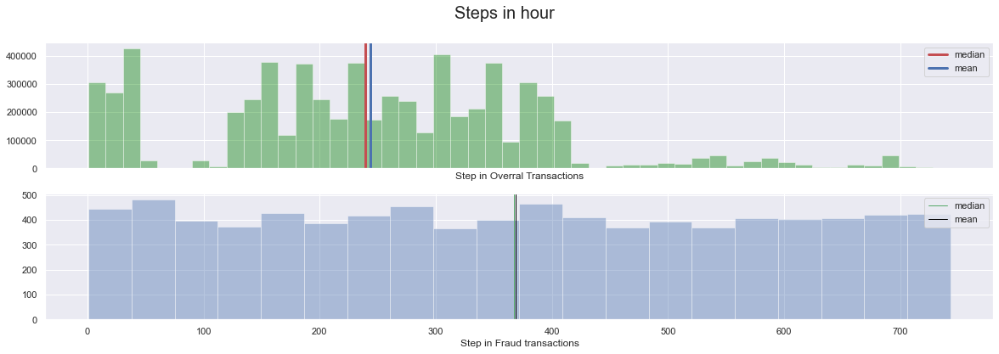

In [11]:
# mean and median
df_step_mean = df.step.mean()
df_step_median = df.step.median()
fraud_step_mean = fraud.step.mean()
fraud_step_median = fraud.step.median()

# ploting first histogram
fig, axs = plt.subplots(nrows= 2, ncols=1, figsize=(20,6), sharex=True)
fig.suptitle('Steps in hour', fontsize=20)
sns.distplot(df.step, kde=False, ax=axs[0], color='green')
axs[0].set_xlabel('Step in Overral Transactions')
axs[0].axvline(df_step_median, color = 'r', linewidth = 3, label = 'median')
axs[0].axvline(df_step_mean, color='b', linewidth = 3, label = 'mean')
axs[0].legend()

# ploting second histogram
sns.distplot(fraud.step, kde=False, ax=axs[1])
axs[1].set_xlabel('Step in Fraud transactions')
axs[1].axvline(fraud_step_median, color = 'g', linewidth = 1, label = 'median')
axs[1].axvline(fraud_step_mean, color='black', linewidth = 1, label = 'mean')
axs[1].legend()
plt.show()

## Trends

Define pattern of change.

Theoretically, the difference between a previous transaction and a subsequent one would be equal to the total transferred:

- `amount` = `oldbalanceOrg` - `newbalanceOrig`

The same could be say for Destinations:

- `newbalanceDest` = `amount` + `oldbalanceDest`

Some `amount` are higher than the `oldbalanceOrg`.

Some `newbalanceDest` are smaller than `oldbalanceDest`

A new feature will be created to check this.

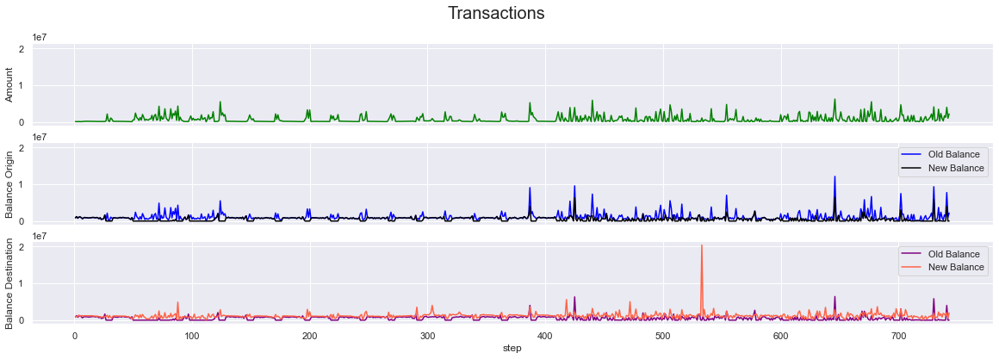

In [12]:
fig, axs = plt.subplots(nrows= 3, ncols=1, figsize=(20,6), sharex=True, sharey=True)
fig.suptitle('Transactions', fontsize=20)
# amount linechart
sns.lineplot(data = df, x='step', y='amount', ax=axs[0], color='green', ci=None)
axs[0].set_ylabel('Amount')

# origin balance linechart
sns.lineplot(data = df, x='step', y='oldbalanceOrg', ax=axs[1], color='blue', ci=None, label='Old Balance')
sns.lineplot(data = df, x='step', y='newbalanceOrig', ax=axs[1], color='black', ci=None, label='New Balance')
axs[1].set_ylabel('Balance Origin')
axs[1].legend()

# destination balance linechart
sns.lineplot(data = df, x='step', y='newbalanceOrig', ax=axs[2], color='purple', ci=None, label='Old Balance')
sns.lineplot(data = df, x='step', y='newbalanceDest', ax=axs[2], color='tomato', ci=None, label='New Balance')
axs[2].set_ylabel('Balance Destination')
axs[2].legend()
plt.show()

# Variables Filtering

This step aims to remove the outliers from the dataset. As previously checked in the descriptive statistics, some features have a huge range of values, particularly the amount, destination balance before the transaction `oldbalanceDest` and the destination balance after the transaction `newbalanceDest`, as shown in the boxplot below.

## Removing Outliers
Creating a function to drop outliers:

In [13]:
def drop_outliers(var: str, dataset: pd.DataFrame):

    # find Q1, Q3 e IQR
    Q1 = np.quantile(dataset[var], .25)
    Q3 = np.quantile(dataset[var], .75)
    IQR = Q3 - Q1

    # calculates the outliers boundaries through statistical relationship
    low = Q1 - 1.5 * IQR
    high = Q3 + 1.5 * IQR

    dados_resultado = dataset.loc[(dataset[var] > low) & (dataset[var] < high)]
    return dados_resultado

In [14]:
df = drop_outliers('amount', df)
df = drop_outliers('oldbalanceOrg', df)
df = drop_outliers('newbalanceDest', df)
df = drop_outliers('oldbalanceDest', df)
df = drop_outliers('newbalanceDest', df)
df.shape

(3564102, 11)

# Feature Engineering

* Motivated by the possibility of zero-balances serving to differentiate between fraudulent and genuine transactions, 2 new features (columns) will be created and recording errors in the originating and destination accounts for each transaction. These new features turn out to be important in obtaining the best performance from the ML algorithm that we will finally use.
* Column day can be created based on the step information to determine the day in which the transactions happened, in order to ease the analysis.

In [15]:
# adding error columns
df['error_Orig'] = df.oldbalanceOrg - df.newbalanceOrig - df.amount
df['error_Dest'] = df.oldbalanceDest - df.newbalanceDest + df.amount 
df.head()

,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud,error_Orig,error_Dest
0,1,PAYMENT,9839.64,C1231006815,170136.0,160296.36,M1979787155,0.0,0.0,0,0,1.455192e-11,9839.64
1,1,PAYMENT,1864.28,C1666544295,21249.0,19384.72,M2044282225,0.0,0.0,0,0,-1.136868e-12,1864.28
2,1,TRANSFER,181.00,C1305486145,181.0,0.00,C553264065,0.0,0.0,1,0,0.000000e+00,181.00
3,1,CASH_OUT,181.00,C840083671,181.0,0.00,C38997010,21182.0,0.0,1,0,0.000000e+00,21363.00
4,1,PAYMENT,11668.14,C2048537720,41554.0,29885.86,M1230701703,0.0,0.0,0,0,0.000000e+00,11668.14


In [16]:
# days columns
df['days'] = df.step.apply(lambda x: round(x / 24) + 1)
print(df.days.unique())
df.head()

[ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32]


,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud,error_Orig,error_Dest,days
0,1,PAYMENT,9839.64,C1231006815,170136.0,160296.36,M1979787155,0.0,0.0,0,0,1.455192e-11,9839.64,1
1,1,PAYMENT,1864.28,C1666544295,21249.0,19384.72,M2044282225,0.0,0.0,0,0,-1.136868e-12,1864.28,1
2,1,TRANSFER,181.00,C1305486145,181.0,0.00,C553264065,0.0,0.0,1,0,0.000000e+00,181.00,1
3,1,CASH_OUT,181.00,C840083671,181.0,0.00,C38997010,21182.0,0.0,1,0,0.000000e+00,21363.00,1
4,1,PAYMENT,11668.14,C2048537720,41554.0,29885.86,M1230701703,0.0,0.0,0,0,0.000000e+00,11668.14,1


As seen earlier, Fraud Transactions only occours in Transactions and Cash Out type. A new Data will be created based on these two parameters.

In [17]:
# creating a data with fraud type
df2 = df.loc[(df.type == 'TRANSFER') | (df.type == 'CASH_OUT')]
print(df2.shape)

(1138726, 14)


# EDA - Exploratory Data Analysis

## Boxplot

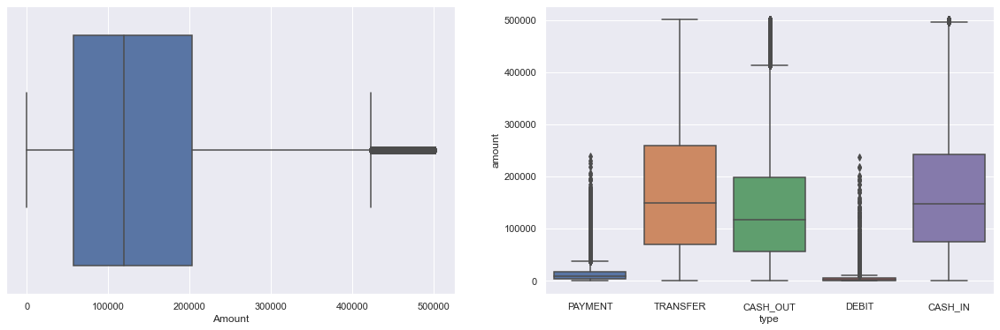

In [18]:
# boxplot amount and your types
plt.figure(figsize=(20, 6))
plt.subplot(1,2,1)
sns.boxplot(df2.amount)
plt.xlabel('Amount')

plt.subplot(1,2,2)
sns.boxplot(x='type', y='amount', data=df)
plt.show()

## New Trends

* Fraudulent Transactions Amount do not reach 200,000.00.
* Frauds tend to 

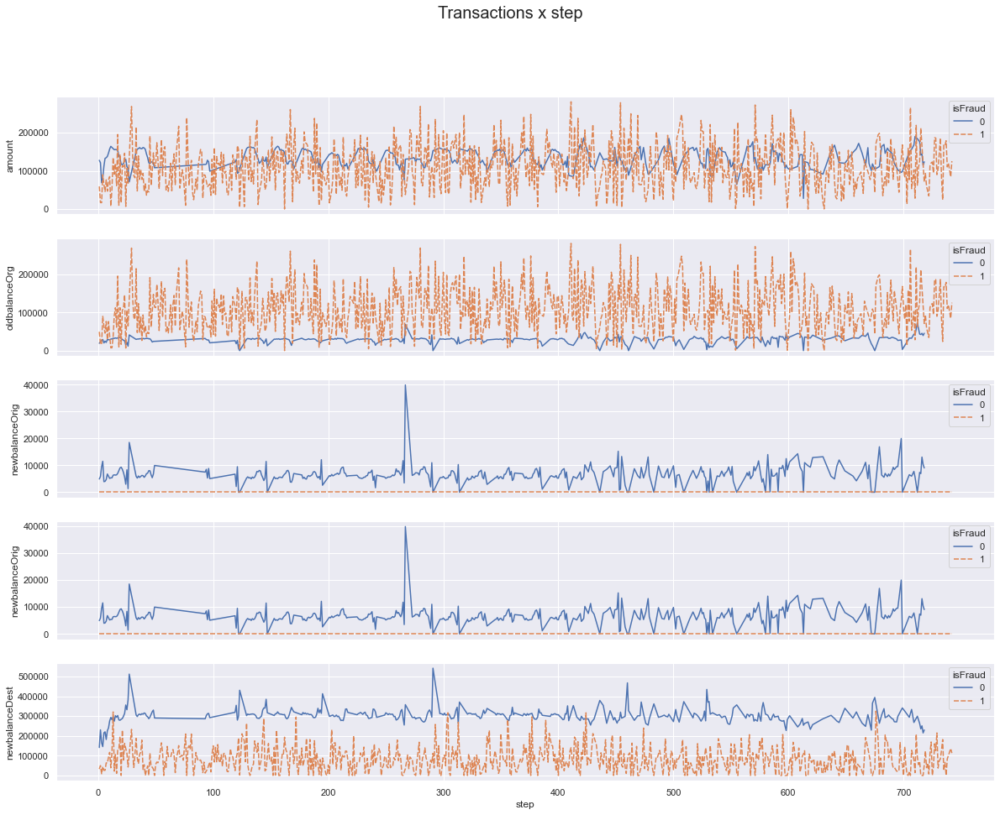

In [19]:
fig, axs = plt.subplots(nrows= 5, ncols=1, figsize=(20,15), sharex=True)
fig.suptitle('Transactions x step', fontsize=20)

# amount 
sns.lineplot(data = df2, hue='isFraud', x='step', y='amount', ax=axs[0], ci=None, style='isFraud')


# origin balance 
sns.lineplot(data = df2, hue='isFraud', x='step', y='oldbalanceOrg', ax=axs[1], ci=None, style='isFraud')
sns.lineplot(data = df2, hue='isFraud', x='step', y='newbalanceOrig', ax=axs[2], ci=None, style='isFraud')


# destination balance 
sns.lineplot(data = df2, hue='isFraud', x='step', y='newbalanceOrig', ax=axs[3], ci=None, style='isFraud')
sns.lineplot(data = df2, hue='isFraud', x='step', y='newbalanceDest', ax=axs[4], ci=None, style='isFraud')

plt.show()

# Bivariate analysis - Hypotheses validation

## H.1. Fraud occour with high values amount.
### True

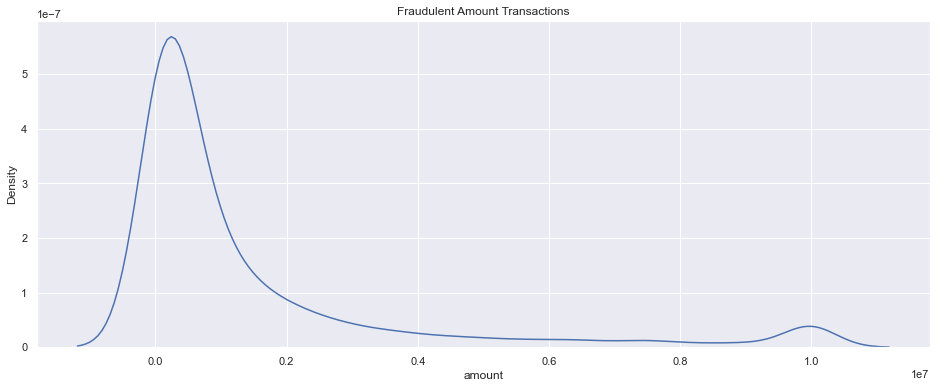

In [20]:
plt.figure(figsize=(16,6))
sns.kdeplot(data=fraud['amount'], label='Fraudulent Amount')
plt.title('Fraudulent Amount Transactions')
plt.show()

## H.2. Fraud not occour when oldbalanceOrg is equal to zero. 
### False

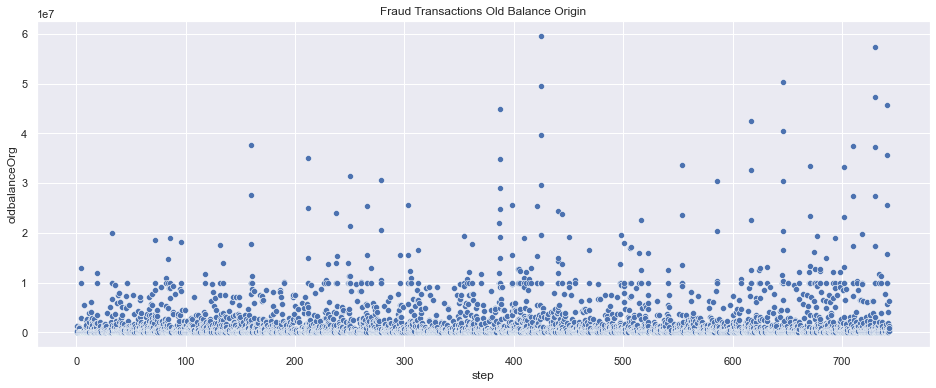

In [21]:
plt.figure(figsize=(16,6))
sns.scatterplot(data=fraud, x='step', y='oldbalanceOrg')
plt.title('Fraud Transactions Old Balance Origin')
plt.show()

In [22]:
fraud['oldbalanceOrg'].describe()

count    8.213000e+03
mean     1.649668e+06
std      3.547719e+06
min      0.000000e+00
25%      1.258224e+05
50%      4.389835e+05
75%      1.517771e+06
max      5.958504e+07
Name: oldbalanceOrg, dtype: float64

## H.3. Fraud not occour when newbalanceOrig is equal to zero.
### False

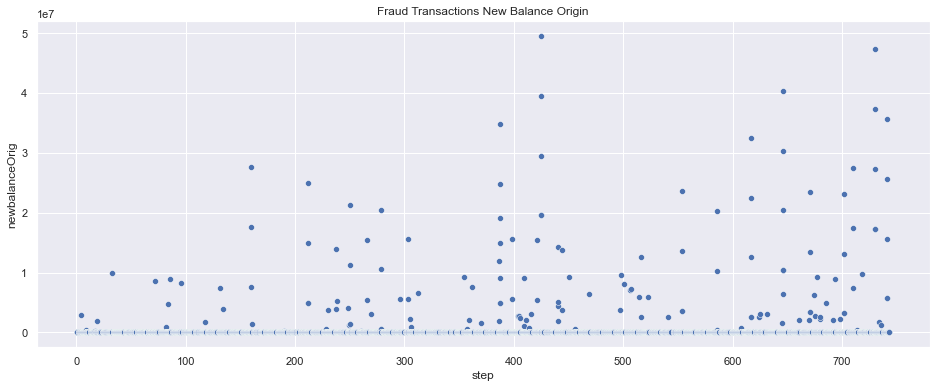

In [23]:
plt.figure(figsize=(16,6))
sns.scatterplot(data=fraud, x='step', y='newbalanceOrig')
plt.title('Fraud Transactions New Balance Origin')
plt.show()

In [24]:
fraud['newbalanceOrig'].describe()

count    8.213000e+03
mean     1.923926e+05
std      1.965666e+06
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      0.000000e+00
max      4.958504e+07
Name: newbalanceOrig, dtype: float64

## H.4. Fraud occour when oldbalanceDest is equal to zero.
### True

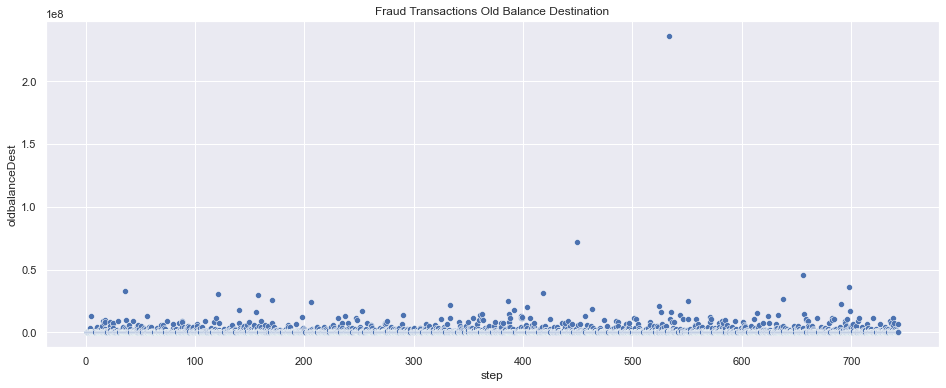

In [25]:
plt.figure(figsize=(16,6))
sns.scatterplot(data=fraud, x='step', y='oldbalanceDest')
plt.title('Fraud Transactions Old Balance Destination')
plt.show()

In [26]:
fraud['oldbalanceDest'].describe()

count    8.213000e+03
mean     5.442496e+05
std      3.336421e+06
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      1.478287e+05
max      2.362305e+08
Name: oldbalanceDest, dtype: float64

## H.5. Fraud occour when newbalanceOrig is equal to zero.
### True

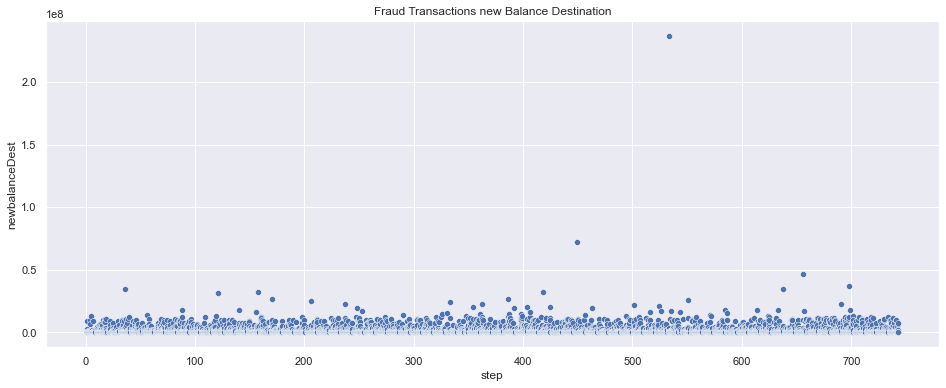

In [27]:
plt.figure(figsize=(16,6))
sns.scatterplot(data=fraud, x='step', y='newbalanceDest')
plt.title('Fraud Transactions new Balance Destination')
plt.show()

In [28]:
fraud['amount'].describe()

count    8.213000e+03
mean     1.467967e+06
std      2.404253e+06
min      0.000000e+00
25%      1.270913e+05
50%      4.414234e+05
75%      1.517771e+06
max      1.000000e+07
Name: amount, dtype: float64

## H.6. Fraud occour with cash out and transfer
### True

In [29]:
fraud.type.unique()

array(['TRANSFER', 'CASH_OUT'], dtype=object)

# Preprocessing

## Dummy Variables
In this step, dummy variables are created to deal with the categorical variables. Dummy variables will turn the categories per variable into its own binary identifier.
* 0 = Cash out
* 1 = Transfer

In [30]:
df2.type = pd.get_dummies(df2.type)
print(df2.shape)
df2.head()

(1138726, 14)


,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud,error_Orig,error_Dest,days
2,1,0,181.00,C1305486145,181.00,0.0,C553264065,0.0,0.00,1,0,0.00,181.00,1
3,1,1,181.00,C840083671,181.00,0.0,C38997010,21182.0,0.00,1,0,0.00,21363.00,1
15,1,1,229133.94,C905080434,15325.00,0.0,C476402209,5083.0,51513.44,0,0,-213808.94,182703.50,1
19,1,0,215310.30,C1670993182,705.00,0.0,C1100439041,22425.0,0.00,0,0,-214605.30,237735.30,1
42,1,1,110414.71,C768216420,26845.41,0.0,C1509514333,288800.0,2415.16,0,0,-83569.30,396799.55,1


## Checkpoint

In [31]:
# checkpoint 1
df2.to_csv('dataset/df2.csv', index=False)

In [32]:
# loading df2 data
df2 = pd.read_csv('dataset/df2.csv')

In [33]:
# Y is the targeting column and X is the rest
X1 = df2.drop(columns=['nameOrig', 'nameDest', 'isFraud', 'isFlaggedFraud', 'days'])
Y1 = df2['isFraud']

# save set for future notebook work
X1.to_csv('dataset/train_set_v02.csv', index=False)
Y1.to_csv('dataset/test_set_v02.csv', index=False)

In [34]:
# load data
X = pd.read_csv('dataset/train_set_v02.csv')
Y = pd.read_csv('dataset/test_set_v02.csv')

## Splitting Data
For start the machine learning model, the data needs to be split into train and validation sets.  In this split 20% of the data is reserved for the final validations, while 80% is kept for training the model.

In [35]:
# split the data into chunks
X_train, X_val, Y_train, Y_val = train_test_split(X, Y, test_size=0.2, random_state=42)

# print train and values
print(X_train.shape)
print(X_val.shape)
print(Y_train.shape)
print(Y_val.shape)

(910980, 9)
(227746, 9)
(910980, 1)
(227746, 1)


In [36]:
X_train.head()

,step,type,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,error_Orig,error_Dest
861363,347,1,283794.38,11666.0,0.00,0.00,473882.01,-2.721284e+05,-1.900876e+05
755154,306,1,3244.67,48902.0,45657.33,0.00,3244.67,-1.818989e-12,0.000000e+00
483753,212,1,224226.55,89844.0,0.00,234196.01,458422.56,-1.343825e+05,0.000000e+00
506903,228,1,164300.50,2587.0,0.00,0.00,164300.50,-1.617135e+05,0.000000e+00
592144,254,1,69241.62,0.0,0.00,140918.77,210160.39,-6.924162e+04,-2.910383e-11


# Prediction

## Model Building
Now it's time to create some models. For this project three common algorithms will be used to make predictions. 

The respective modeules for Logistic Regression, Decision Trees, Random Trees and XGBoost.

> Target Variable = `isFraud`
* 0 - non fraud
* 1 - fraud

## Logistic Regression
The first model is logistic regression.

In [39]:
lr = LogisticRegression()

In [40]:
lr.fit(X_train, Y_train)
lr_pred = lr.predict(X_val)

In [41]:
acc = accuracy_score(Y_val, lr_pred)
precision = precision_score(Y_val, lr_pred)
recall = recall_score(Y_val, lr_pred)
f1 = f1_score(Y_val, lr_pred)

logistic_regression = pd.DataFrame(
    [['Logistic Regression', acc, precision, recall, f1]],
    columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score']
     )

## Decision Trees

In [42]:
dt = DecisionTreeClassifier()
dt.fit(X_train, Y_train)

DecisionTreeClassifier()

In [43]:
dt_pred = dt.predict(X_val)

In [44]:
acc = accuracy_score(Y_val, dt_pred)
precision = precision_score(Y_val, dt_pred)
recall = recall_score(Y_val, dt_pred)
f1 = f1_score(Y_val, dt_pred)

decision_tree = pd.DataFrame(
    [['Decision Tree Classifier', acc, precision, recall, f1]],
    columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score']
     )

## Random Forest

In [45]:
rf = RandomForestClassifier(n_estimators = 42).fit(X_train, Y_train)

In [46]:
rf_predict = rf.predict(X_val)

In [47]:
acc = accuracy_score(Y_val, rf_predict)
precision = precision_score(Y_val, rf_predict)
recall = recall_score(Y_val, rf_predict)
f1 = f1_score(Y_val, rf_predict)

random_forest = pd.DataFrame(
    [['Random Forest', acc, precision, recall, f1]],
    columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score']
     )

## XGBoost Classifier

In [48]:
xgb = XGBClassifier().fit(X_train, Y_train)

In [49]:
xgb_predict = xgb.predict(X_val)

In [50]:
acc = accuracy_score(Y_val, xgb_predict)
precision = precision_score(Y_val, xgb_predict)
recall = recall_score(Y_val, xgb_predict)
f1 = f1_score(Y_val, xgb_predict)

xg_boost = pd.DataFrame(
    [['XGB', acc, precision, recall, f1]],
    columns = ['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score']
     )

## Confusion Matrix
Confusion matrix of the results with the true values on the y axis and predicted values along the x axis. Since the diagonals are lighter in color and have higher numbers, the accuracy is going to be high since those are the True Positives.

In [51]:
# logistic regression
cmLR = confusion_matrix(Y_val, lr_pred)
cm_LR = pd.DataFrame(cmLR, columns=['predicted_non_fraud', 'predicted_fraud'], index=['actual_non_fraud', 'actual_fraud'])

# decision trees
cmDT = confusion_matrix(Y_val, dt_pred)
cm_DT = pd.DataFrame(cmDT, columns=['predicted_non_fraud', 'predicted_fraud'], index=['actual_non_fraud', 'actual_fraud'])

# random forest
cmRF = confusion_matrix(Y_val, rf_predict)
cm_RF = pd.DataFrame(cmRF, columns=['predicted_non_fraud', 'predicted_fraud'], index=['actual_non_fraud', 'actual_fraud'])

# XGBoost
cmXG = confusion_matrix(Y_val, xgb_predict)
cm_XG = pd.DataFrame(cmXG, columns=['predicted_non_fraud', 'predicted_fraud'], index=['actual_non_fraud', 'actual_fraud'])

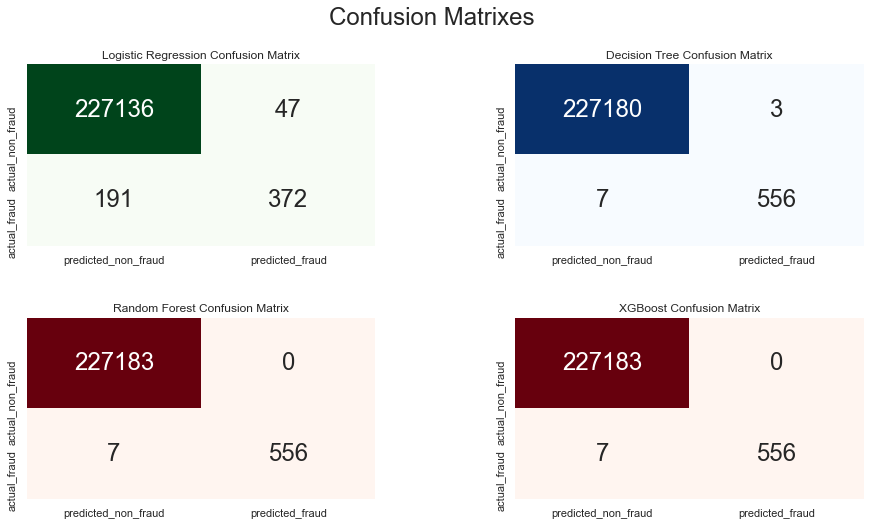

In [52]:
plt.figure(figsize=(15,8))

plt.suptitle("Confusion Matrixes",fontsize=24)
plt.subplots_adjust(wspace = 0.4, hspace= 0.4)

plt.subplot(2,2,1)
plt.title("Logistic Regression Confusion Matrix")
sns.heatmap(cm_LR,annot=True,cmap="Greens",fmt="d",cbar=False, annot_kws={"size": 24})

plt.subplot(2,2,2)
plt.title("Decision Tree Confusion Matrix")
sns.heatmap(cm_DT,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

plt.subplot(2,2,3)
plt.title("Random Forest Confusion Matrix")
sns.heatmap(cm_RF,annot=True,cmap="Reds",fmt="d",cbar=False, annot_kws={"size": 24})

plt.subplot(2,2,4)
plt.title("XGBoost Confusion Matrix")
sns.heatmap(cm_XG,annot=True,cmap="Reds",fmt="d",cbar=False, annot_kws={"size": 24})
plt.show()

## Machine Learning Scores

In [53]:
ml_scores = pd.concat([logistic_regression, decision_tree, random_forest, xg_boost], ignore_index=True)
ml_scores

,Model,Accuracy,Precision,Recall,F1 Score
0,Logistic Regression,0.998955,0.887828,0.660746,0.757637
1,Decision Tree Classifier,0.999956,0.994633,0.987567,0.991087
2,Random Forest,0.999969,1.000000,0.987567,0.993744
3,XGB,0.999969,1.000000,0.987567,0.993744


## Computing cross-validated metrics
Selecting the best model results such: Random Forest and XGBoost, who showed better performance.

In [54]:
scores_xgb = cross_val_score(xgb, X, Y, cv=5, scoring='f1_macro')
print("%0.5f XGBoost accuracy with a standard deviation of %0.5f" % (scores_xgb.mean(), scores_xgb.std()))
scores_xgb

0.99811 XGBoost accuracy with a standard deviation of 0.00274


array([0.99280106, 0.99821307, 0.99955446, 1.        , 1.        ])

In [55]:
scores_rf = cross_val_score(rf, X, Y, cv=5, scoring='f1_macro')
print("%0.5f Random Forest accuracy with a standard deviation of %0.5f" % (scores_rf.mean(), scores_rf.std()))
scores_rf

0.80533 Random Forest accuracy with a standard deviation of 0.38420


array([0.99235797, 0.99776832, 0.99955446, 1.        , 0.03694585])

# Conclusion

## Questions

Answering questions based on the best performing Machine Learning Model: **Decision Tree** and **Random Forest**. 

* The company will receive 25% of the value of each transaction detected as *fraud*.
* The company will receive 5% of the value of each transaction detected as *fraud*, but the transaction is *legitimate*.
* The company will return 100% of the value to the customer, for each transaction detected as legitimate, however a transaction is a fraud.

Median amount of a transaction: \$7,4871.8 (we're using the median because the amount distribution is highly skewed).

Portfolio: 6,362,620 transactions (fraudulent + non fraudulent).
* True positive amount = [0.25 x (median amount) x (number of TP transactions)]
* False positive amount = [0.05 x (median amount) x (number of FP transactions)]
* False negative amount = [1 x (median amount) x (number of FN transactions)]

## Preparing Test Set

In [56]:
df3 = df.drop(columns=['nameOrig', 'nameDest', 'isFlaggedFraud', 'isFraud', 'days'], axis=1).copy()
df3.type = df3.type.map(
    {
    'TRANSFER' : 0,
    'CASH_OUT' : 1,
    'PAYMENT' : 2,
    'DEBIT' : 3,
    'CASH_IN' : 4
    }
)

print(df3.shape)
df3.head()

(3564102, 9)


,step,type,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,error_Orig,error_Dest
0,1,2,9839.64,170136.0,160296.36,0.0,0.0,1.455192e-11,9839.64
1,1,2,1864.28,21249.0,19384.72,0.0,0.0,-1.136868e-12,1864.28
2,1,0,181.00,181.0,0.00,0.0,0.0,0.000000e+00,181.00
3,1,1,181.00,181.0,0.00,21182.0,0.0,0.000000e+00,21363.00
4,1,2,11668.14,41554.0,29885.86,0.0,0.0,0.000000e+00,11668.14


In [57]:
predict_xgb = xgb.predict(df3)
predict_rf = rf.predict(df3)

In [58]:
# adding fraud column
df3['isFraud'] = df.isFraud

# adding predict with XGBoost
df3['predictions_xgb'] = predict_xgb

# adding predict with Random Forest
df3['predictions_rf'] = predict_rf

## Company Profit

In [60]:
# join predictions on the test set in order to calculate the business performance
print('Random Forest prediction')

# the company receive 25% of each transaction value truly detected as fraud
fraud_detected = df3[(df3['isFraud'] == 1) & (df3['predictions_rf'] == 1)]
fraud_detected_amount = fraud_detected[['amount', 'isFraud', 'predictions_rf']].groupby(['isFraud', 'predictions_rf']).sum().reset_index()
fraud_detected_amount['to_receive'] = fraud_detected_amount['amount'] * 0.25

# the company receive 5% of each transaction value truly detected as fraud
fraud_detected_leg = df3[(df3['isFraud'] == 0) & (df3['predictions_rf'] == 1)]
fraud_detected_leg_amount = fraud_detected_leg[['amount', 'isFraud', 'predictions_rf']].groupby(['isFraud', 'predictions_rf']).sum().reset_index()
fraud_detected_leg_amount['to_receive'] = fraud_detected_leg_amount['amount']*0.05

# the company gives back 100% of the value for the customer in each transaction detected as Legitimate
fraud_not_detected = df3[(df3['isFraud'] == 1) & (df3['predictions_rf'] == 0)]
fraud_not_detected_amount = fraud_not_detected[['amount', 'isFraud', 'predictions_rf']].\
    groupby(['isFraud', 'predictions_rf']).sum().reset_index()

# print results
print('The company will receive ${:,.2f} due to transactions truly detected as fraud'.format(fraud_detected_amount['to_receive'][0]))
print('The company will receive ${:,.2f} due to transactions detected as fraud, but actually legitimate'.\
      format(fraud_detected_leg_amount['to_receive'][0]))
print('The company will give back ${:,.2f} due to transactions detected as legitimate, but actually fraud'.\
      format(fraud_not_detected_amount['amount'][0]))
      
# the company profit
print('---' * 20)
profit = fraud_detected_amount['to_receive'][0] + fraud_detected_leg_amount['to_receive'][0] - fraud_not_detected_amount['amount'][0]
print(f'\nThe Blocker Fraud Company forecasted profit: ${profit:,.2f}')

Random Forest prediction
The company will receive $75,821,054.67 due to transactions truly detected as fraud
The company will receive $13,492.30 due to transactions detected as fraud, but actually legitimate
The company will give back $1,627,479.30 due to transactions detected as legitimate, but actually fraud
------------------------------------------------------------

The Blocker Fraud Company forecasted profit: $74,207,067.67
